In [1]:
# import the modules of polartoolkit
from polartoolkit import regions, fetch, maps, profiles, utils

In [2]:
# set hemisphere as south
import os
os.environ['POLARTOOLKIT_HEMISPHERE'] = 'south'

## Regions

* Pre-defined or interactively chosen geographic regions 
* in polar stereographic projections (EPSG:3031 or 3413)
* in the format [x min, x max, y min, y max]

### Pre-defined

In [3]:
regions?

Type:        module
String form: <module 'polartoolkit.regions' from '/home/mdtanker/miniforge3/envs/ptk/lib/python3.12/site-packages/polartoolkit/regions.py'>
File:        ~/miniforge3/envs/ptk/lib/python3.12/site-packages/polartoolkit/regions.py
Docstring:  
Bounding regions for commonly plotted polar regions. In stereographic projections. The
format is (xmin, xmax, ymin, ymax), in meters.

In [4]:
# from polartoolkit import regions
regions.get_regions()

{'antarctica': (-2800000.0, 2800000.0, -2800000.0, 2800000.0),
 'west_antarctica': (-2740000.0, 570000.0, -2150000.0, 1670000.0),
 'east_antarctica': (-840000.0, 2880000.0, -2400000.0, 2600000.0),
 'antarctic_peninsula': (-2600000.0, -1200000.0, 170000.0, 1800000.0),
 'marie_byrd_land': (-1500000.0, -500000.0, -1350000.0, -800000.0),
 'victoria_land': (100000.0, 1000000.0, -2200000.0, -1000000.0),
 'saunders_coast': (-980000.0, -600000.0, -1350000.0, -1100000.0),
 'roosevelt_island': (-480000.0, -240000.0, -1220000.0, -980000.0),
 'ross_island': (210000.0, 360000.0, -1400000.0, -1250000.0),
 'minna_bluff': (210000.0, 390000.0, -1310000.0, -1120000.0),
 'mcmurdo_dry_valleys': (320000.0, 480000.0, -1400000.0, -1220000.0),
 'siple_coast': (-700000.0, 30000.0, -1110000.0, -450000.0),
 'crary_ice_rise': (-330000.0, -40000.0, -830000.0, -480000.0),
 'siple_dome': (-630000.0, -270000.0, -970000.0, -630000.0),
 'ross_ice_shelf': (-680000.0, 470000.0, -1420000.0, -310000.0),
 'nickerson_ice_she

In [5]:
regions.ross_ice_shelf

(-680000.0, 470000.0, -1420000.0, -310000.0)

In [6]:
# Add all region strings to dictionary
region_dict = regions.get_regions()

# extract antarctic and greenland strings
antarctic_strings = []
for x in list(region_dict.keys()):
    if x == "greenland":
        break
    else:
        antarctic_strings.append(x)

# subset dict for antarctica and greenland
antarctic_regions = {k: region_dict[k] for k in antarctic_strings}

# remove large regions to not crowd plots
remove = ["antarctica", "west_antarctica", "east_antarctica"]
[antarctic_regions.pop(key, None) for key in remove]

fig = maps.plot_grd(
    grid=fetch.modis(hemisphere="south"),
    modis=True,
    frame="+gblack",
)

from statistics import mean

for k, v in antarctic_regions.items():
    maps.add_box(fig, v, pen=".6p,magenta")
    if k not in [
        "minna_bluff",
        "mcmurdo_dry_valleys",
        "siple_dome",
        "siple_coast",
        "roosevelt_island",
        "ross_island",
        "crary_ice_rise",
        "kamb_ice_stream",
    ]:
        fig.text(
            x=mean([v[1], v[0]]),
            y=v[3],
            text=k,
            justify="CB",
            offset="0/.1",
            no_clip=True,
            font="6p,Helvetica,black",
            fill="white",
        )


Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use official parameters (overriding the ones from GeoTIFF keys), or to GEOKEYS to use custom values from GeoTIFF keys and drop the EPSG code.
Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use official parameters (overriding the ones from GeoTIFF keys), or to GEOKEYS to use custom values from GeoTIFF keys and drop the EPSG code.
Warning 1: The definition of geographic CRS EPSG:4326 got from GeoTIFF keys is not the same as the one from the EPSG registry, which may cause issues during reprojection operations. Set GTIFF_SRS_SOURCE configuration option to EPSG to use officia

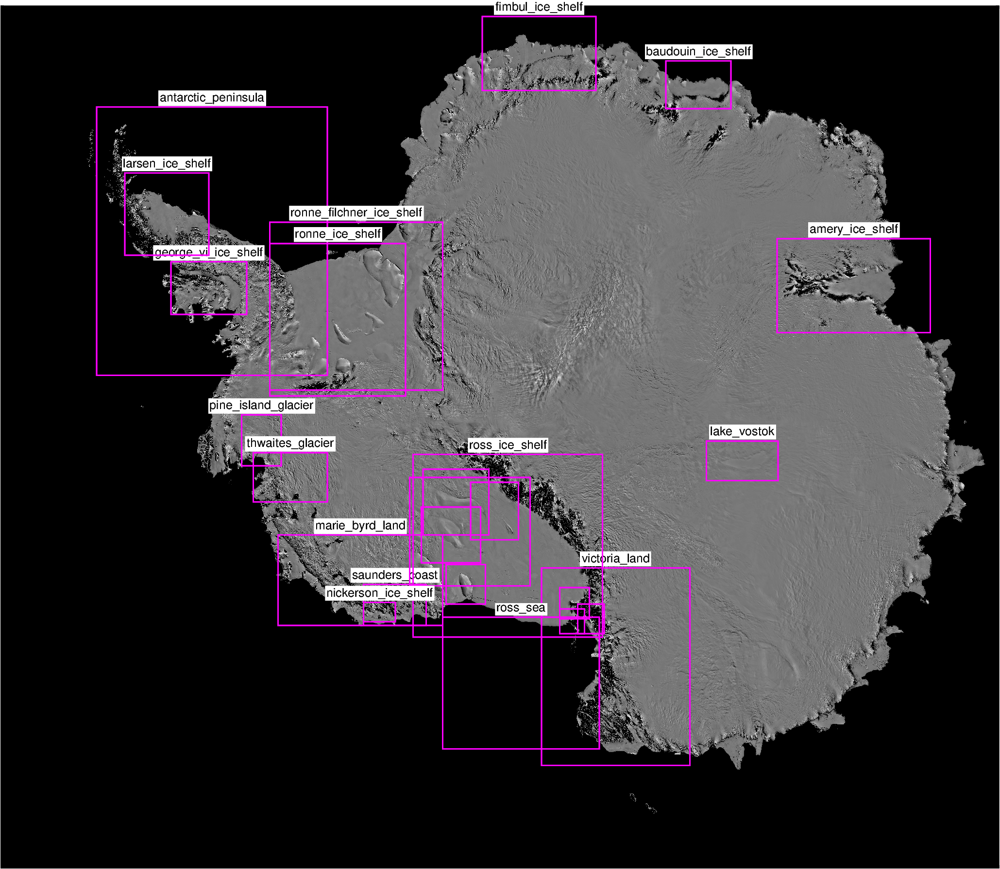

In [7]:
fig.show()

### Interactively-defined

In [8]:
polygon = regions.draw_region()

Label(value='')

Map(center=[-90, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [10]:
region = utils.polygon_to_region(polygon)
region

(np.float64(-1913363.1091896943),
 np.float64(-1805785.4048696102),
 np.float64(21173.006350131367),
 np.float64(150197.0164682603))

## Fetch
download, pre-process and cache common polar datasets

See [all available datasets](https://polartoolkit.readthedocs.io/en/latest/datasets/index.html), the [Antarctic datasets](https://polartoolkit.readthedocs.io/en/latest/datasets/antarctica/index.html) or the [Arctic datasets](https://polartoolkit.readthedocs.io/en/latest/datasets/greenland_arctic/index.html).

In [11]:
import pooch
pooch.os_cache("pooch/polartoolkit")

PosixPath('/home/mdtanker/.cache/pooch/polartoolkit')

In [12]:
fetch.get_fetches()

['antarctic_boundaries',
 'basal_melt',
 'bedmachine',
 'bedmap2',
 'bedmap_points',
 'crustal_thickness',
 'deepbedmap',
 'etopo',
 'geoid',
 'geomap',
 'ghf',
 'gia',
 'gravity',
 'groundingline',
 'ibcso',
 'ibcso_coverage',
 'ice_vel',
 'imagery',
 'magnetics',
 'mass_change',
 'measures_boundaries',
 'modis',
 'modis_moa',
 'modis_mog',
 'moho',
 'rema',
 'sediment_thickness']

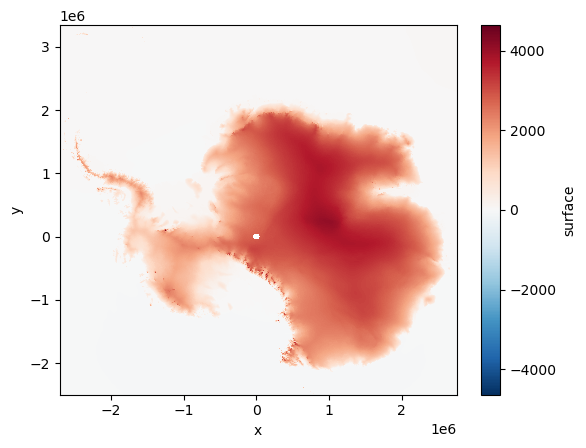

In [13]:
# simple fetch call
rema_grid = fetch.rema()

rema_grid.plot()

In [14]:
fetch.bedmap2?

Signature:
fetch.bedmap2(
    layer: 'str',
    reference: 'str' = 'eigen-gl04c',
    region: 'tuple[float, float, float, float] | None' = None,
    spacing: 'float | None' = None,
    registration: 'str | None' = None,
    fill_nans: 'bool' = False,
) -> 'xr.DataArray'
Docstring:
Load bedmap2 data as xarray.DataArrays
from :footcite:t:`fretwellbedmap22013`.
accessed from https://ramadda.data.bas.ac.uk/repository/entry/show?entryid=fa5d606c-dc95-47ee-9016-7a82e446f2f2.

All grids are by default referenced to the EIGEN-GL04C geoid. Use the
reference='ellipsoid' to convert to the WGS-84 ellipsoid or reference='eigen-6c4' to
convert to the EIGEN-6c4 geoid.

Unlike Bedmachine data, Bedmap2 surface and icethickness contain NaN's over the
ocean, instead of 0's. To fill these NaN's with 0's, set `fill_nans=True`.
Note, this only makes since if the reference is the geoid, therefore, if
`reference='ellipsoid` and `fill_nans=True`, the nan's will be filled before
converting the results to the ge

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.


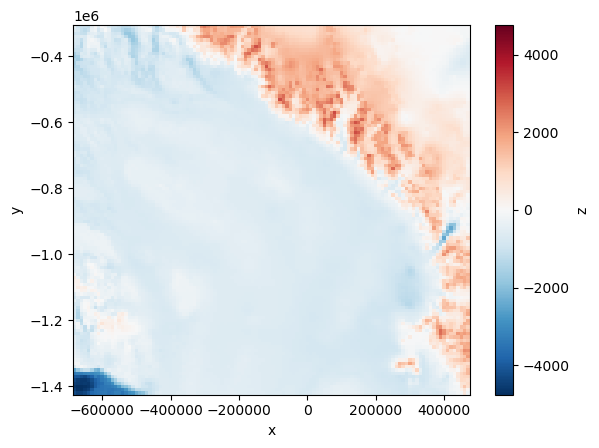

In [15]:
# optional parameters
bed_grid_subset = fetch.bedmap2(
    layer="bed",
    region=regions.ross_ice_shelf,
    spacing=10_000,
    reference="ellipsoid",
)
bed_grid_subset.plot()

grdcut [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: w reset from -1913363.10919 to -1913500
grdcut [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: e reset from -1805785.40487 to -1805500
grdcut [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdcut [WARNING]: s reset from 21173.0063501 to 20800
grdcut [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdcut [WARNING]: n reset from 150197.016468 to 150400
grdcut [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: w reset from -1913363.10919 to -1913400
grdcut [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: e reset from -1805785.40487 to -1805400
grdcut [WARNING]: (s - 

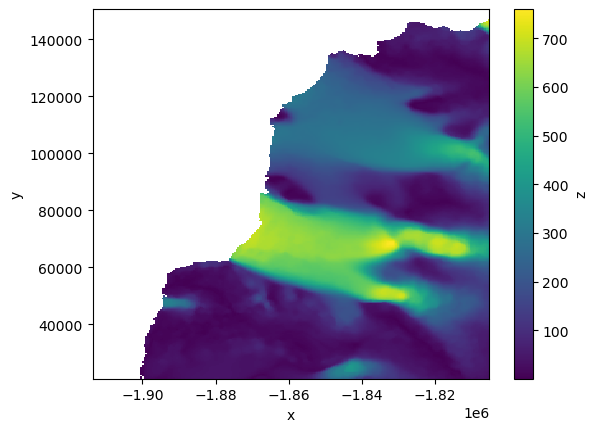

In [16]:
# downloading NASA EarthAccess data (MEaSUREs Ice Velocity)
ice_vel_grid = fetch.ice_vel(
    region=region,
    spacing=450,
)
ice_vel_grid.plot()

## Maps
* Create high-quality maps tailored to polar settings
* All data should be polar stereographic (EPSG 3031 or 3413)
* Uses PyGMT for all plotting

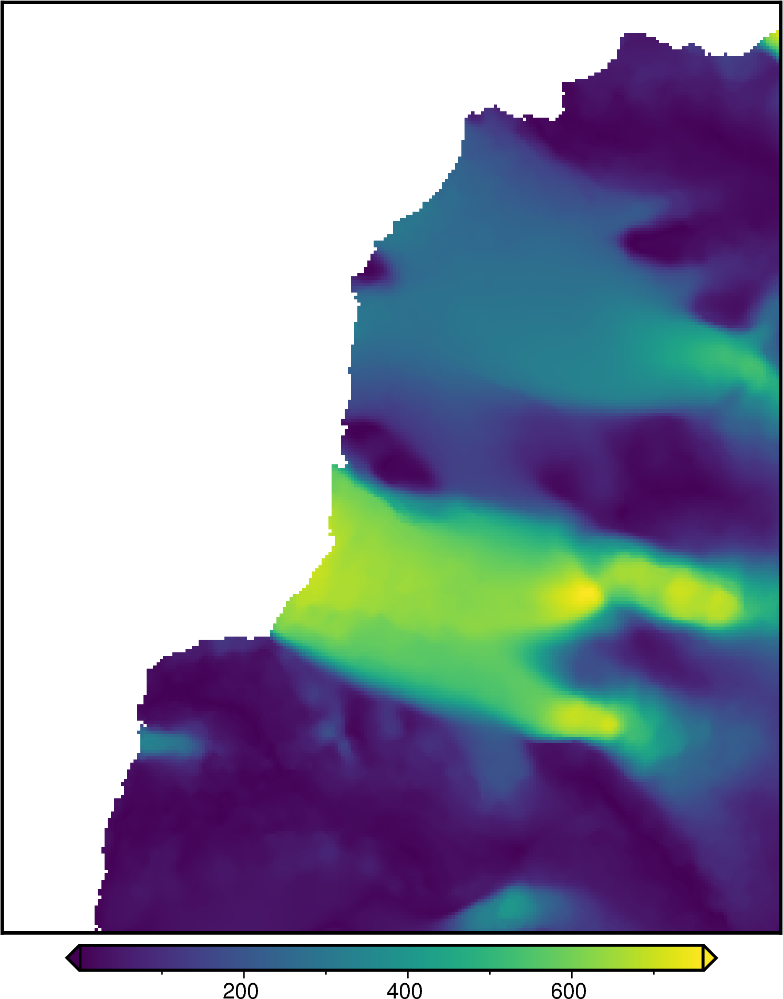

In [17]:
# simple map
fig = maps.plot_grd(ice_vel_grid)
fig.show()

In [18]:
maps.plot_grd?

Signature:
maps.plot_grd(
    grid: 'str | xr.DataArray',
    region: 'tuple[float, float, float, float] | None' = None,
    hemisphere: 'str | None' = None,
    cmap: 'str | bool' = 'viridis',
    coast: 'bool' = False,
    north_arrow: 'bool' = False,
    scalebar: 'bool' = False,
    faults: 'bool' = False,
    imagery_basemap: 'bool' = False,
    title: 'str | None' = None,
    inset: 'bool' = False,
    points: 'pd.DataFrame | None' = None,
    gridlines: 'bool' = False,
    origin_shift: 'str | None' = 'initialize',
    fig: 'pygmt.Figure | None' = None,
    **kwargs: 'typing.Any',
) -> 'pygmt.Figure'
Docstring:
Plot a grid (either a filename or a load dataarray) with PyGMT in a polar
stereographic projection, and add a range of features such as coastline and
grounding lines, inset figure location maps, background imagery, colorbar histogram,
scalebars, gridlines and northarrows. Reuse the figure instance to either plot
additional features on top, or shift the plot to create subp

grdimage [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: w reset from -1913400 to -1913441.95582
grdimage [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdimage [WARNING]: e reset from -1805400 to -1805197.21877
grdimage [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: s reset from 21150 to 21134.9649512
grdimage [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdimage [WARNING]: n reset from 150300 to 150494.965229
gmtset [WARNING]: Representation of font type not recognized. Using default.


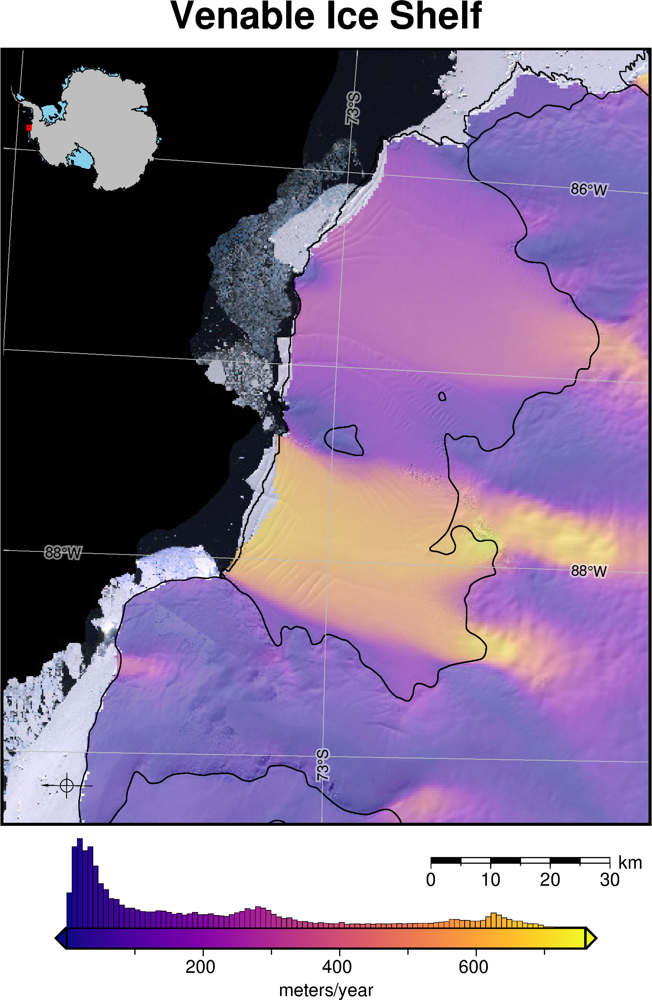

In [19]:
# add features
fig = maps.plot_grd(
    ice_vel_grid,
    cmap="plasma",
    cbar_label="meters/year",
    hist=True,
    transparency=50,

    coast=True,
    inset=True,
    gridlines=True,
    x_spacing=1,
    y_spacing=.5,
    scalebar=True,
    scale_position="n.8/-.05",
    north_arrow=True,

    title="Venable Ice Shelf",

    imagery_basemap=True,
)
fig.show()

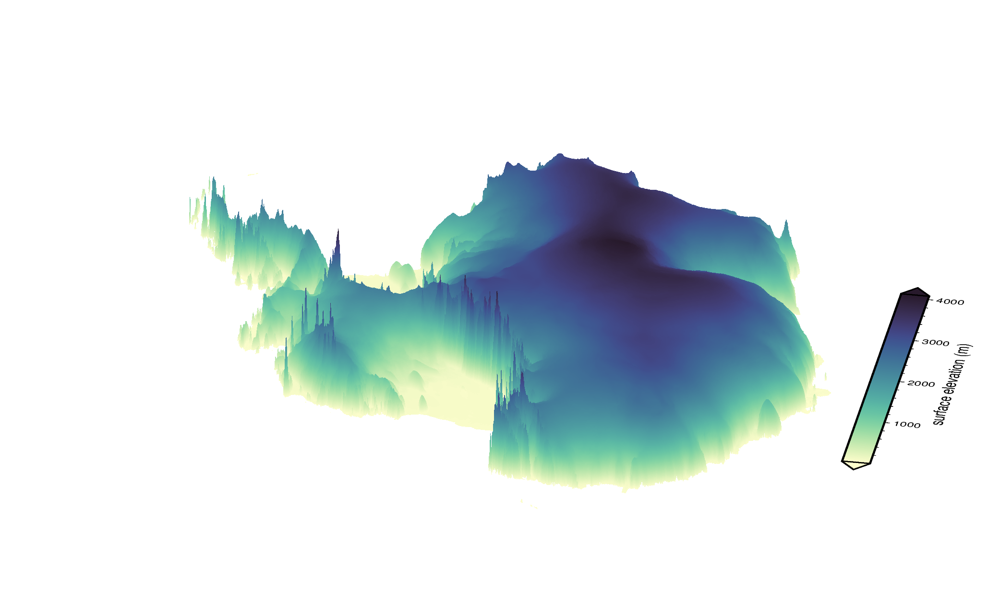

In [20]:
fig = maps.plot_3d(
    grids=fetch.bedmap2(layer="surface"),
    cmaps="deep",
    exaggeration=2,
    cbar_labels="surface elevation (m)",
)
fig.show()

In [21]:
# # define the region of interest
# region = (150e3, 550e3, -1350e3, -1100e3)

# # plot the imagery and some additional map features
# fig = maps.plot_grd(
#     fetch.imagery(),
#     region=region,
#     inset=True,
#     title="LIMA imagery",
#     gridlines=True,
#     x_spacing=10,
#     y_spacing=2,
#     colorbar=False,
#     hemisphere="south",
# )

# # add surface elevation contours
# fig.grdcontour(grid=fetch.bedmap2(layer="surface"), levels=500, pen="thick,red")

# # add a point and label
# fig.plot(x=285000, y=-1130000, style="a0.5c", pen="1p,black", fill="darkorange")
# fig.text(x=285000, y=-1130000, text="Discovery Deep", offset="0c/.5c")

# fig.show()

## Profiles
* Define a line
    * point to point
    * shapefile
    * interactively defined
* Sample topography / data along it 
    * supply your own data via dictionaries
    * topography defaults to BedMachine or Bedmap2 
    * data defaults to gravity and magnetics
* Plot profiles, cross-sections and location maps

gmtset [WARNING]: Representation of font type not recognized. Using default.


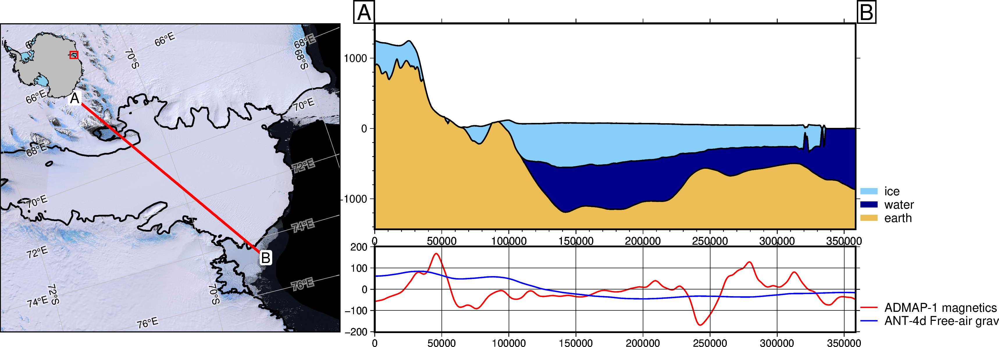

In [22]:
a = (1925000, 830000)
b = (2200000, 600000)

fig, _, _ = profiles.plot_profile(
    method="points",
    start=a,
    stop=b,
    add_map=True,
    data_dict="default",
)
fig.show()

In [23]:
lines = profiles.draw_lines()

Label(value='')

Map(center=[-90, 0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [25]:
# extract the vertices of the line
df = utils.shapes_to_df(lines)

gmtset [WARNING]: Representation of font type not recognized. Using default.


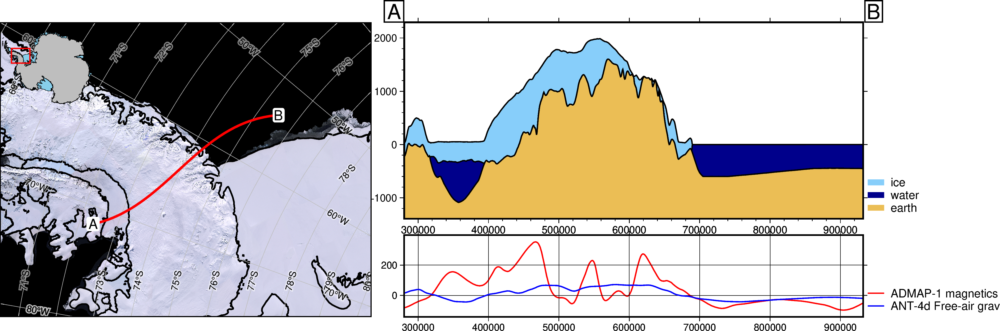

In [26]:
fig, _, _ = profiles.plot_profile(
    method="polyline",
    polyline=df,
    add_map=True,
    data_dict="default",
    num=1000,
)
fig.show()

## Utils
* Common geospatial tasks

* masking
* reprojecting
* resampling grids
* extract data information
* fit and remove trends
* compare grids

In [27]:
# download data
bedmachine = fetch.bedmachine("bed")
bedmap = fetch.bedmap2("bed")

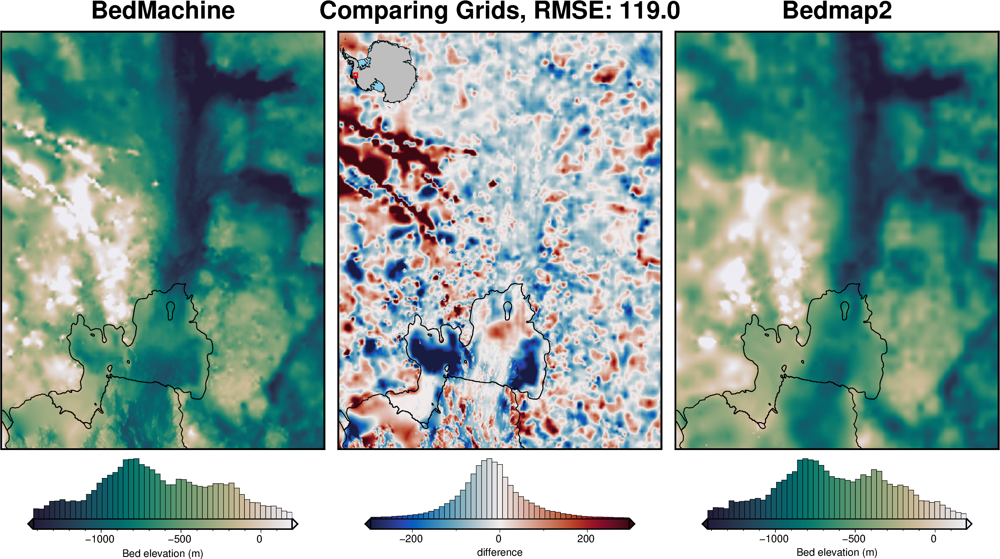

In [28]:
# compare grids and plot
_ = utils.grd_compare(
    bedmachine,
    bedmap,

    # plotting parameters
    region=regions.pine_island_glacier,
    plot=True,
    coast=True,
    robust=True,
    grid1_name="BedMachine",
    grid2_name="Bedmap2",
    cbar_label="Bed elevation (m)",
    cmap="rain",
    reverse_cpt=True,
    hist=True,
    hist_bin_num=50,
)

## Exploring data
Plot gridded or point data and interactively explore them

In [29]:
# fetch bed topography data at 20km resolution
bedmap2_bed = fetch.bedmap2(layer="bed", region=regions.minna_bluff)

# fetch geothermal heat flux point measurements
GHF_point_data = fetch.ghf(version="burton-johnson-2020", points=True)

# subset points in region of interest
GHF_point_data = utils.points_inside_region(GHF_point_data, regions.minna_bluff)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
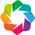

:Overlay
   .Path.I   :Path   [Longitude,Latitude]   (Id,Id_text,Area_km2)
   .Image.I  :Image   [x,y]   (z)
   .Points.I :Points   [x,y]   (GHF)
   .Path.II  :Path   [Longitude,Latitude]   (Id,Id_text,Area_km2)

In [30]:
maps.interactive_data(
    grid=bedmap2_bed,
    points=GHF_point_data[["x", "y", "GHF"]],
    points_z="GHF",
    coast=True,
)

In [31]:
# set hemisphere as north
import os
os.environ['POLARTOOLKIT_HEMISPHERE'] = 'north'

In [32]:
import pandas as pd

# project Lat Long into EPSG3413 Polar Stereographic
xy=utils.latlon_to_epsg3413([69.764858, -49.439688])

# turn into bounding region
robins_region = regions.alter_region([xy[0], xy[0], xy[1], xy[1]], zoom=-10e3)
robins_region

(-181398.11444736997,
 -161398.11444736997,
 -2217525.8382105236,
 -2197525.8382105236)

In [33]:
# Download ice velocity and bed elevation
gr_ice_vel = fetch.ice_vel(spacing=450, region=robins_region)
bed = fetch.bedmachine(layer="bed", region=robins_region)

grdsample [WARNING]: Output sampling interval in x exceeds input interval and may lead to aliasing.
grdsample [WARNING]: Output sampling interval in y exceeds input interval and may lead to aliasing.
grdcut [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: w reset from -181398.114447 to -181400
grdcut [WARNING]: (e - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: e reset from -161398.114447 to -161300
grdcut [WARNING]: (s - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdcut [WARNING]: s reset from -2217525.83821 to -2217650
grdcut [WARNING]: (n - y_min) must equal (NY + eps) * y_inc), where NY is an integer and |eps| <= 0.0001.
grdcut [WARNING]: n reset from -2197525.83821 to -2197400
grdcut [WARNING]: (w - x_min) must equal (NX + eps) * x_inc), where NX is an integer and |eps| <= 0.0001.
grdcut [WARNING]: w reset from -181398.1

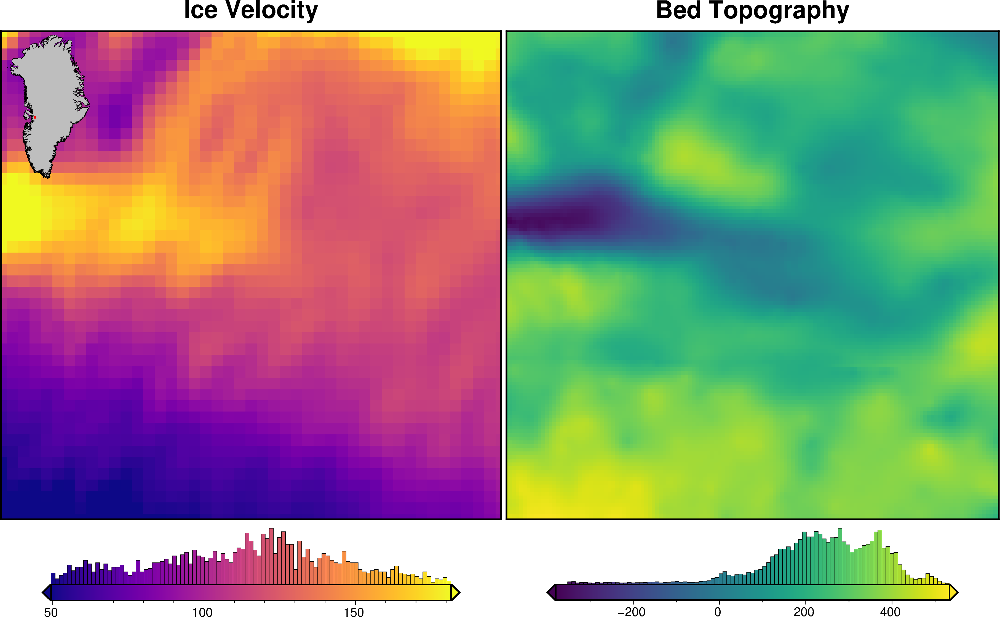

In [34]:
fig = maps.plot_grd(
    gr_ice_vel,
    cmap="plasma",
    title='Ice Velocity',
    robust=True,
    hist=True,
    inset=True,
    inset_position="jTR",
    inset_width=.3,
)
fig = maps.plot_grd(
    bed,
    origin_shift="xshift",
    fig=fig,
    title="Bed Topography",
    hist=True
)
fig.show()


In [35]:
# # make a dictionary for data to plot along provide
# data_dict = profiles.make_data_dict(
#     ["Free air gravity", "Ice velocity"],
#     [
#         fetch.gravity(version="antgg-2021", anomaly_type="FA"),
#         fetch.ice_vel(),
#     ],
#     ["blue", "red"],
#     axes=[0,1],
# )